In [1]:
import xarray as xr
import gcsfs
from glob import glob
from dask.diagnostics import ProgressBar, Profiler
import dask
import os
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline
import random

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
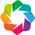

In [2]:
import holoviews as hv
from holoviews import opts
from holoviews.operation.datashader import datashade, shade, dynspread, rasterize
import datashader
hv.extension('bokeh')

In [3]:
import keras
import tensorflow as tf

Using TensorFlow backend.
/srv/conda/envs/notebook/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:526: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint8 = np.dtype([("qint8", np.int8, 1)])
/srv/conda/envs/notebook/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:527: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_quint8 = np.dtype([("quint8", np.uint8, 1)])
/srv/conda/envs/notebook/lib/python3.7/site-packages/tensorflow/python/framework/dtypes.py:528: FutureWarning: Passing (type, 1) or '1type' as a synonym of type is deprecated; in a future version of numpy, it will be understood as (type, (1,)) / '(1,)type'.
  _np_qint16 = np.dtype([("qint16", np.int16, 1)])
/srv/conda/envs/notebook/lib/python3.7/site-packag

In [4]:
from xbatcher import BatchGenerator

In [5]:
from IPython.display import clear_output


In [6]:
import intake
cat_url = 'https://raw.githubusercontent.com/pangeo-data/pangeo-datastore/master/intake-catalogs/master.yaml'
cat = intake.Catalog(cat_url)
ds = cat.ocean.CESM_POP.CESM_POP_hires_control.to_dask()
ds

/srv/conda/envs/notebook/lib/python3.7/site-packages/intake/source/discovery.py:136: FutureWarning: The drivers ['geojson', 'postgis', 'shapefile', 'spatialite'] do not specify entry_points and were only discovered via a package scan. This may break in a future release of intake. The packages should be updated.
  FutureWarning)
/srv/conda/envs/notebook/lib/python3.7/site-packages/fsspec/implementations/local.py:32: FutureWarning: The default value of auto_mkdir=True has been deprecated and will be changed to auto_mkdir=False by default in a future release.
  FutureWarning,


<xarray.Dataset>
Dimensions:             (nlat: 2400, nlon: 3600, time: 14965, z_t: 62, z_t_150m: 15, z_w: 62, z_w_bot: 62, z_w_top: 62)
Coordinates:
    ANGLE               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    ANGLET              (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DXT                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DXU                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DYT                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DYU                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HT                  (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HTE                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HTN                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HU                  (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HUS                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HUW                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    KMT                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    KMU                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    REGION_MASK         (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    T0_Kelvin           float64 ...
    TAREA               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    TLAT                (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    TLONG               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    UAREA               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    ULAT                (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    ULONG               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    cp_air              float64 ...
    cp_sw               float64 ...
    days_in_norm_year   timedelta64[ns] ...
    dz                  (z_t) float32 dask.array<chunksize=(62,), meta=np.ndarray>
    dzw                 (z_w) float32 dask.array<chunksize=(62,), meta=np.ndarray>
    fwflux_factor       float64 ...
    grav                float64 ...
    heat_to_PW          float64 ...
    hflux_factor        float64 ...
    latent_heat_fusion  float64 ...
    latent_heat_vapor   float64 ...
    mass_to_Sv          float64 ...
    momentum_factor     float64 ...
    nsurface_t          float64 ...
    nsurface_u          float64 ...
    ocn_ref_salinity    float64 ...
    omega               float64 ...
    ppt_to_salt         float64 ...
    radius              float64 ...
    rho_air             float64 ...
    rho_fw              float64 ...
    rho_sw              float64 ...
    salinity_factor     float64 ...
    salt_to_Svppt       float64 ...
    salt_to_mmday       float64 ...
    salt_to_ppt         float64 ...
    sea_ice_salinity    float64 ...
    sflux_factor        float64 ...
    sound               float64 ...
    stefan_boltzmann    float64 ...
  * time                (time) object 0046-01-02 00:00:00 ... 0087-01-01 00:00:00
    vonkar              float64 ...
  * z_t                 (z_t) float32 500.0 1500.0 ... 562499.06 587499.06
  * z_t_150m            (z_t_150m) float32 500.0 1500.0 ... 13500.0 14500.0
  * z_w                 (z_w) float32 0.0 1000.0 2000.0 ... 549999.06 574999.06
  * z_w_bot             (z_w_bot) float32 1000.0 2000.0 ... 574999.06 599999.06
  * z_w_top             (z_w_top) float32 0.0 1000.0 ... 549999.06 574999.06
Dimensions without coordinates: nlat, nlon
Data variables:
    HMXL_2              (time,

In [7]:
ds=ds.rename({'U1_1':'U', 'V1_1':'V', 'TAUX_2':'TAUX', 'TAUY_2':'TAUY', 'SSH_2':'SSH', 'ULONG':'XU', 'ULAT':'YU'})
ds

<xarray.Dataset>
Dimensions:             (nlat: 2400, nlon: 3600, time: 14965, z_t: 62, z_t_150m: 15, z_w: 62, z_w_bot: 62, z_w_top: 62)
Coordinates:
    ANGLE               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    ANGLET              (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DXT                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DXU                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DYT                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DYU                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HT                  (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HTE                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HTN                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HU                  (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HUS                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HUW                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    KMT                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    KMU                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    REGION_MASK         (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    T0_Kelvin           float64 ...
    TAREA               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    TLAT                (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    TLONG               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    UAREA               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    YU                  (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    XU                  (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    cp_air              float64 ...
    cp_sw               float64 ...
    days_in_norm_year   timedelta64[ns] ...
    dz                  (z_t) float32 dask.array<chunksize=(62,), meta=np.ndarray>
    dzw                 (z_w) float32 dask.array<chunksize=(62,), meta=np.ndarray>
    fwflux_factor       float64 ...
    grav                float64 ...
    heat_to_PW          float64 ...
    hflux_factor        float64 ...
    latent_heat_fusion  float64 ...
    latent_heat_vapor   float64 ...
    mass_to_Sv          float64 ...
    momentum_factor     float64 ...
    nsurface_t          float64 ...
    nsurface_u          float64 ...
    ocn_ref_salinity    float64 ...
    omega               float64 ...
    ppt_to_salt         float64 ...
    radius              float64 ...
    rho_air             float64 ...
    rho_fw              float64 ...
    rho_sw              float64 ...
    salinity_factor     float64 ...
    salt_to_Svppt       float64 ...
    salt_to_mmday       float64 ...
    salt_to_ppt         float64 ...
    sea_ice_salinity    float64 ...
    sflux_factor        float64 ...
    sound               float64 ...
    stefan_boltzmann    float64 ...
  * time                (time) object 0046-01-02 00:00:00 ... 0087-01-01 00:00:00
    vonkar              float64 ...
  * z_t                 (z_t) float32 500.0 1500.0 ... 562499.06 587499.06
  * z_t_150m            (z_t_150m) float32 500.0 1500.0 ... 13500.0 14500.0
  * z_w                 (z_w) float32 0.0 1000.0 2000.0 ... 549999.06 574999.06
  * z_w_bot             (z_w_bot) float32 1000.0 2000.0 ... 574999.06 599999.06
  * z_w_top             (z_w_top) float32 0.0 1000.0 ... 549999.06 574999.06
Dimensions without coordinates: nlat, nlon
Data variables:
    HMXL_2              (time,

In [8]:
def make_3d_coords(lon,lat):
    X = np.sin(np.radians(lat))
    Y = np.sin(np.radians(lon))*np.cos(np.radians(lat))
    Z = -np.cos(np.radians(lon))*np.cos(np.radians(lat))
    return (X,Y,Z)

X, Y, Z = make_3d_coords(ds.XU.data, ds.YU.data)
ds['X'] = ds.XU.dims, X
ds['Y'] = ds.XU.dims, Y
ds['Z'] = ds.XU.dims, Z
ds

<xarray.Dataset>
Dimensions:             (nlat: 2400, nlon: 3600, time: 14965, z_t: 62, z_t_150m: 15, z_w: 62, z_w_bot: 62, z_w_top: 62)
Coordinates:
    ANGLE               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    ANGLET              (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DXT                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DXU                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DYT                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DYU                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HT                  (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HTE                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HTN                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HU                  (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HUS                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    HUW                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    KMT                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    KMU                 (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    REGION_MASK         (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    T0_Kelvin           float64 ...
    TAREA               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    TLAT                (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    TLONG               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    UAREA               (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    YU                  (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    XU                  (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    cp_air              float64 ...
    cp_sw               float64 ...
    days_in_norm_year   timedelta64[ns] ...
    dz                  (z_t) float32 dask.array<chunksize=(62,), meta=np.ndarray>
    dzw                 (z_w) float32 dask.array<chunksize=(62,), meta=np.ndarray>
    fwflux_factor       float64 ...
    grav                float64 ...
    heat_to_PW          float64 ...
    hflux_factor        float64 ...
    latent_heat_fusion  float64 ...
    latent_heat_vapor   float64 ...
    mass_to_Sv          float64 ...
    momentum_factor     float64 ...
    nsurface_t          float64 ...
    nsurface_u          float64 ...
    ocn_ref_salinity    float64 ...
    omega               float64 ...
    ppt_to_salt         float64 ...
    radius              float64 ...
    rho_air             float64 ...
    rho_fw              float64 ...
    rho_sw              float64 ...
    salinity_factor     float64 ...
    salt_to_Svppt       float64 ...
    salt_to_mmday       float64 ...
    salt_to_ppt         float64 ...
    sea_ice_salinity    float64 ...
    sflux_factor        float64 ...
    sound               float64 ...
    stefan_boltzmann    float64 ...
  * time                (time) object 0046-01-02 00:00:00 ... 0087-01-01 00:00:00
    vonkar              float64 ...
  * z_t                 (z_t) float32 500.0 1500.0 ... 562499.06 587499.06
  * z_t_150m            (z_t_150m) float32 500.0 1500.0 ... 13500.0 14500.0
  * z_w                 (z_w) float32 0.0 1000.0 2000.0 ... 549999.06 574999.06
  * z_w_bot             (z_w_bot) float32 1000.0 2000.0 ... 574999.06 599999.06
  * z_w_top             (z_w_top) float32 0.0 1000.0 ... 549999.06 574999.06
Dimensions without coordinates: nlat, nlon
Data variables:
    HMXL_2              (time,

In [9]:
def shift_variables(ds, shift_vars, corner_points=True):
    """Augment xarray dataset with shifted versions of all variables in
    `shift_vars` list."""
    
    # needed to deal with different xbatcher possibilities 
    if 'nlon_input' in ds.dims:
        xdim = 'nlon_input'
    else:
        xdim = 'nlon'
    if 'nlat_input' in ds.dims:
        ydim = 'nlat_input'
    else:
        ydim = 'nlat'  
        
    ds = ds.copy()
    shift_vars = ['SSH','SST','TAUX','TAUY', 'X', 'Y', 'Z']

    shifts = {'_e': {xdim: -1},
              '_w': {xdim: 1},
             '_n': {ydim: -1},
             '_s': {ydim: 1}}
    if corner_points:
        shifts.update({
             '_ne': {xdim: -1, ydim: -1},
             '_nw': {xdim: 1, ydim: -1},
             '_se': {xdim: -1, ydim: 1},
             '_sw': {xdim: 1, ydim: 1}})

    for var in shift_vars:
        for suf, shift in shifts.items():
            ds[var + suf] = ds[var].shift(**shift)
    return ds

In [10]:
def geostrophic_vel(ds):

    d_eta_dx = 0.5*(ds.SSH_e - ds.SSH_w)/ds.DXT
    d_eta_dy = 0.5*(ds.SSH_n - ds.SSH_s)/ds.DYT

    Om = 7.2921e-5
    g = 9.81e2
    f = 2 * Om * np.sin(np.deg2rad(ds.YU))
    u_g = - g * d_eta_dy * f**-1
    v_g = g * d_eta_dx * f**-1
    
    mask_lat = ((ds.YU>5)|(ds.YU<-5))
    ds['ug'] = u_g.where(mask_lat)
    ds['vg'] = v_g.where(mask_lat)
    return ds


In [11]:
def residual_vel(ds):
    #ds0 = ds.isel(time=11).reset_coords()[default_variables + ['YU','DXT','DYT']]
    d_eta_dx = 0.5*(ds.SSH_e - ds.SSH_w)/ds.DXT
    d_eta_dy = 0.5*(ds.SSH_n - ds.SSH_s)/ds.DYT

    Om = 7.2921e-5
    g = 9.81e2
    f = 2 * Om * np.sin(np.deg2rad(ds.YU))
    u_g = - g * d_eta_dy * f**-1
    v_g = g * d_eta_dx * f**-1
    
    mask_lat = ((ds.YU>5)|(ds.YU<-5))
    mask_tot = ~(np.isnan(ds.SSH) | np.isnan(ds.SSH_e) | np.isnan(ds.SSH_w) |
                 np.isnan(ds.SSH_n) | np.isnan(ds.SSH_s)| np.isnan(ds.SSH_ne) |
                 np.isnan(ds.SSH_nw)| np.isnan(ds.SSH_se)| np.isnan(ds.SSH_sw) |
                 np.isnan(ds.SST) | np.isnan(ds.SST_e) | np.isnan(ds.SST_w) |
                 np.isnan(ds.SST_n) | np.isnan(ds.SST_s)| np.isnan(ds.SST_ne) |
                 np.isnan(ds.SST_nw)| np.isnan(ds.SST_se)| np.isnan(ds.SST_sw) |
                 np.isnan(ds.TAUX) | np.isnan(ds.TAUX_e) | np.isnan(ds.TAUX_w) |
                 np.isnan(ds.TAUX_n) | np.isnan(ds.TAUX_s)| np.isnan(ds.TAUX_ne) |
                 np.isnan(ds.TAUX_nw)| np.isnan(ds.TAUX_se)| np.isnan(ds.TAUX_sw) |
                 np.isnan(ds.TAUY) | np.isnan(ds.TAUY_e) | np.isnan(ds.TAUY_w) |
                 np.isnan(ds.TAUY_n) | np.isnan(ds.TAUY_s)| np.isnan(ds.TAUY_ne) |
                 np.isnan(ds.TAUY_nw)| np.isnan(ds.TAUY_se)| np.isnan(ds.TAUY_sw) | 
                 np.isnan(ds.U) | np.isnan(ds.V) )
    mask_geo = (mask_tot&mask_lat)
    ug = u_g.where(mask_geo)
    vg = v_g.where(mask_geo)
    ds['u_res'] = ds.U - ug
    ds['v_res'] = ds.V - vg
    return ds

In [12]:
target_cols=['u_res','v_res']
feature_cols = ['X', 'Y', 'Z',
                'X_e','X_w','X_n','X_s',
                'Y_e','Y_w','Y_n','Y_s',
                'Z_e','Z_w','Z_n','Z_s',
                'SSH',
                'SSH_e','SSH_w','SSH_n','SSH_s',
                'SST',
                'SST_e','SST_w','SST_n','SST_s',
                'TAUX',
                'TAUX_e','TAUX_w','TAUX_n','TAUX_s',
                'TAUY',
                'TAUY_e','TAUY_w','TAUY_n','TAUY_s']
coord_cols = ['XU', 'YU']

def transform_batch(batch_ds, return_coords=False):
    """Postprocessing to transform each batch from xbatcher into suitable input for keras."""
    
    batch_w_shift = shift_variables(batch_ds, ['X', 'Y', 'Z', 'SSH', 'SST', 'TAUX', 'TAUY'], 
                                    corner_points=False)
    
    # convert to pandas dataframe, ~15 s
    # the slow part is the dataframe conversion, where you have to call
    # "stack". There is no real way around this. I tried implementing
    # it in numpy, which was a bit faster, but then we can't call
    # .dropna in the next step
    if 'sample' in batch_w_shift:
        batch_w_shift = batch_w_shift.drop('sample')
    df = batch_w_shift.to_dataframe().reset_index(drop=True)
    
    # ~2 s
    df_dropped = df.dropna()

    X = df_dropped.loc[:, feature_cols].values
    y = df_dropped.loc[:, target_cols].values
    
    if return_coords:
        coords = df_dropped.loc[:, coord_cols].values
        return X, y, coords
    else:
        return X, y


default_variables = ['X', 'Y', 'Z', 'u_res', 'v_res', 'TAUX', 'TAUY','SST','SSH']
coord_variables = ['XU', 'YU']

def data_generator(ds, time_indexes=[], sub_batch_size=100, return_coords=False):
    """A generator we can pass to keras's `fit_generator` function.
    
    Returns
    -------
    X : ndarray
        The input features
    y : ndarray
        The targets
    """

    if return_coords:
        variables = default_variables + coord_variables
    else:
        variables = default_variables
    
    bg = BatchGenerator(ds.isel(time=time_indexes).reset_coords()[variables],
                        batch_dims={'time': 1},
                        input_dims={'nlon': 100, 'nlat': 100},
                        input_overlap={'nlon' : 1, 'nlat' : 1},
                        concat_input_dims=True, preload_batch=True)
    
    with dask.config.set(scheduler='single-threaded'):
        for batch in bg:
            print('\n*** Loaded new Batch ***\n')

            bt = transform_batch(batch, return_coords=return_coords)    
            X, y = bt[0], bt[1]

            # randomize full batch
            sample_idx = np.arange(X.shape[0])
            np.random.shuffle(sample_idx)
            X, y = X[sample_idx], y[sample_idx]
        
            if return_coords:
                coords = (bt[2][sample_idx],)
            else:
                coords = ()

            print(f'X.shape, y.shape: {X.shape}, {y.shape}')

            if sub_batch_size:
                n_samples = X.shape[0]
                n_start = np.arange(0, n_samples, sub_batch_size)                
                for i in n_start:
                    imax = min(i + sub_batch_size, n_samples)
                    yield (X[i:imax], y[i:imax]) + coords
            else:
                yield (X, y) + coords

In [13]:
# %time ds0 = ds.isel(time=11).reset_coords()[default_variables + ['XU', 'YU','DXT','DYT']].load()
%time ds = residual_vel(shift_variables(ds.reset_coords()[['X', 'Y', 'Z', 'U', 'V', 'TAUX', 'TAUY','SST','SSH','XU','YU','DXT','DYT']], shift_vars=['SSH']))

ds

CPU times: user 29.4 s, sys: 1.65 s, total: 31.1 s
Wall time: 31.1 s


<xarray.Dataset>
Dimensions:  (nlat: 2400, nlon: 3600, time: 14965)
Coordinates:
  * time     (time) object 0046-01-02 00:00:00 ... 0087-01-01 00:00:00
Dimensions without coordinates: nlat, nlon
Data variables:
    X        (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    Y        (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    Z        (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    U        (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    V        (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    TAUX     (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    TAUY     (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SST      (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SSH      (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    XU       (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    YU       (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DXT      (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    DYT      (nlat, nlon) float64 dask.array<chunksize=(2400, 3600), meta=np.ndarray>
    SSH_e    (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SSH_w    (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SSH_n    (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SSH_s    (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SSH_ne   (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SSH_nw   (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SSH_se   (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SSH_sw   (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SST_e    (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SST_w    (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SST_n    (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SST_s    (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SST_ne   (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SST_nw   (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SST_se   (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    SST_sw   (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    TAUX_e   (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    TAUX_w   (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    TAUX_n   (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    TAUX_s   (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    TAUX_ne  (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    TAUX_nw  (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    TAUX_se  (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    TAUX_sw  (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    TAUY_e   (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    TAUY_w   (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    TAUY_n   (time, nlat, nlon) float32 dask.array<chunksize=(1, 2400, 3600), meta=np.ndarray>
    TAUY_s   (time, nlat, nlon) float32 dask.array<c

In [ ]:
%time ds0 = ds.isel(time=11).load()
%time X, y, coords = transform_batch(ds0, return_coords=True)

/srv/conda/envs/notebook/lib/python3.7/site-packages/dask/core.py:119: RuntimeWarning: divide by zero encountered in reciprocal
  return func(*args2)


CPU times: user 7.47 s, sys: 3.76 s, total: 11.2 s
Wall time: 7.69 s


In [24]:
ke = 0.5*(y**2).sum(axis=1)

In [25]:
data_lonlat = np.hstack([coords, ke[:, None]])
points_lonlat = hv.Points(data_lonlat, kdims=['lon', 'lat'], vdims=['z'], label="points")
agg = datashader.mean('z')
datashade(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=agg,
          cmap=plt.cm.magma,
          ).opts(width=800, height=500)

:DynamicMap   []
   :RGB   [lon,lat]   (R,G,B,A)

In [26]:
# we use day indexes to separate test and training data

training_selector = [30, 40, 50, 100, 700, 900]
testing_selector = [1800]

In [27]:
coords.shape, y.shape, X.shape

((5048757, 2), (5048757, 2), (5048757, 35))

In [28]:
gen = data_generator(ds, training_selector)
%time X, y = next(iter(gen))


*** Loaded new Batch ***

X.shape, y.shape: (4870426, 35), (4870426, 2)
CPU times: user 25.2 s, sys: 12.4 s, total: 37.5 s
Wall time: 40.2 s


In [29]:
%time X, y = next(iter(gen))

CPU times: user 17 µs, sys: 12 µs, total: 29 µs
Wall time: 32.4 µs


In [30]:
X.shape

(100, 35)

In [31]:
y.shape

(100, 2)

In [32]:
nsamples, nfeatures = X.shape
noutput = y.shape[1]

model = keras.Sequential()
model.add(keras.layers.Dense(nfeatures, input_shape=(len(feature_cols),),
                       name='hidden_layer_1',))
model.add(keras.layers.LeakyReLU(alpha=0.3))
model.add(keras.layers.Dense(20, name='hidden_layer_2'))
model.add(keras.layers.LeakyReLU(alpha=0.3))
model.add(keras.layers.Dense(10, name='hidden_layer_3'))
model.add(keras.layers.LeakyReLU(alpha=0.3))
model.add(keras.layers.Dense(noutput, name='output_layer',))
    
# Define your optimizer 
optimizer = tf.train.AdamOptimizer()
model.compile(loss='mae', optimizer=optimizer,metrics=['mae', 'mse','accuracy'])

# show a summary of the data
model.summary()

Instructions for updating:
Colocations handled automatically by placer.
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
hidden_layer_1 (Dense)       (None, 35)                1260      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 35)                0         
_________________________________________________________________
hidden_layer_2 (Dense)       (None, 20)                720       
_________________________________________________________________
leaky_re_lu_2 (LeakyReLU)    (None, 20)                0         
_________________________________________________________________
hidden_layer_3 (Dense)       (None, 10)                210       
_________________________________________________________________
leaky_re_lu_3 (LeakyReLU)    (None, 10)                0         
_________________________________________________________________
outp

In [33]:
model.evaluate(X, y)

100/100 [==============================] - 0s 802us/step


[11.512980880737304, 11.512980880737304, 248.85, 0.53]

In [34]:
plt.rcParams.update({'font.size': 14
    , 'legend.markerscale': 1., 'axes.titlesize': 14, 'axes.labelsize' : 12,
      'legend.fontsize' : 13,'legend.handlelength': 3})

plt.rc('xtick', labelsize=10) 
plt.rc('ytick', labelsize=10)

color2 = '#6495ed'
color1 = '#ff6347'
color5 = '#8470ff'
color3 = '#3cb371'
color4 = '#ffd700'
color6 = '#ba55d3'
plt.rcParams['figure.figsize'] = (14.,5.)

In [35]:
# this will help save training history more frequently
# https://keras.io/callbacks/#create-a-callback

class LossHistory(keras.callbacks.Callback):
    def __init__(self, frequency=100):
        self.frequency = frequency
        self.batch_counter = 0
        self.losses = []
        
    def on_train_begin(self, logs={}):
        self.i = 0
        self.x = []
        self.losses = []
        self.mse = []
        self.accuracy = []
        
        self.fig = plt.figure()
        
        self.logs = []
        
    def on_batch_end(self, batch, logs={}):
        if batch % self.frequency == 0:
            self.batch_counter += self.frequency
            self.logs.append(logs)
            self.x.append(self.i)
            self.losses.append(logs.get('loss'))
            self.mse.append(logs.get('mean_squared_error'))
            self.accuracy.append(logs.get('acc'))
        
            self.i += 1
        
            clear_output(wait=True)
            plt.figure(figsize=(18,5))
            plt.subplot(131)
            plt.plot(self.x, self.losses,color=color2,label="loss")
            plt.legend()
            plt.xlabel(r'batch');
            plt.ylabel('Mean Abs Error');
        
            plt.subplot(132)
            plt.plot(self.x, self.mse,alpha=0.5, label="training")
            plt.legend()
            plt.xlabel('batch');
            plt.ylabel(r'Mean Squared Error [$cm^2/s^2$]');
        
            plt.subplot(133)
            plt.plot(self.x, self.accuracy,color=color2, label="training")
            plt.legend()
            plt.xlabel('batch');
            plt.ylabel('Model Accuracy');
            plt.show();

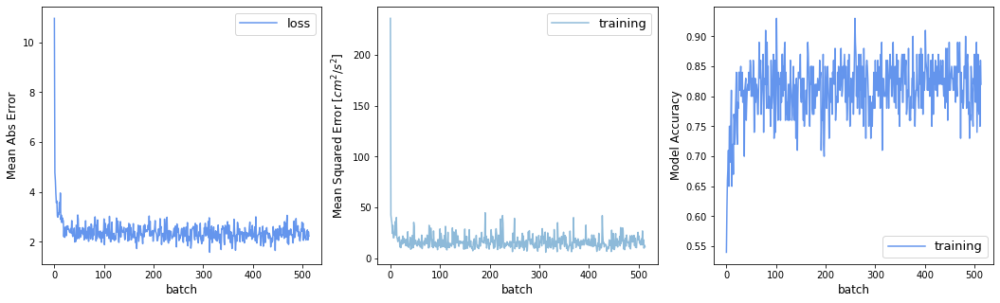

51372/51372 [==============================] - 449s 9ms/step - loss: 2.3805 - mean_absolute_error: 2.3805 - mean_squared_error: 16.4962 - acc: 0.8170


In [36]:
gen = data_generator(ds, training_selector)
history = LossHistory()
steps_per_epoch = 5137262 // 100 # I wish there were a way to pre-know this
model.fit_generator(generator=gen, steps_per_epoch=steps_per_epoch, callbacks=[history])

In [37]:
ds_test = ds.isel(time=testing_selector[0]).reset_coords()[default_variables + ['XU', 'YU']].load()
%time X_test, y_test, coords = transform_batch(ds_test, return_coords=True)

CPU times: user 7.6 s, sys: 11.1 s, total: 18.7 s
Wall time: 18.7 s


In [38]:
model.evaluate(X_test, y_test)

5048767/5048767 [==============================] - 95s 19us/step


[2.475366186144977, 2.475366186144977, 19.505251792687535, 0.8116674823772506]

In [39]:
%time y_pred = model.predict(X_test)

CPU times: user 1min 30s, sys: 36.7 s, total: 2min 7s
Wall time: 1min 4s


In [40]:
# double check that we understand how MAE is calculated
y_err = y_pred - y_test
(abs(y_err)).mean()

2.475366185478815

In [41]:
kdims = ['true (cm/s)', 'predicted (cm/s)']

u_data = np.array([y_test[:, 0], y_pred[:, 0]]).transpose()
u_points = hv.Points(u_data, kdims=kdims, label="U")

v_data = np.array([y_test[:, 1], y_pred[:, 1]]).transpose()
v_points = hv.Points(v_data, kdims=kdims, label="V")

line_1x1 = hv.Path(np.array([[-50, -50], [50, 50]]), kdims=kdims).opts(color='red', line_width=2)

agg = datashader.mean('rms_vel')
(datashade(u_points, cmap=plt.cm.binary) * line_1x1 +
 datashade(v_points, cmap=plt.cm.binary) * line_1x1 
).opts(opts.RGB(width=500, height=500, show_grid=True))

:Layout
   .DynamicMap.I  :DynamicMap   []
      :Overlay
         .RGB.U  :RGB   [true (cm/s),predicted (cm/s)]   (R,G,B,A)
         .Path.I :Path   [true (cm/s),predicted (cm/s)]
   .DynamicMap.II :DynamicMap   []
      :Overlay
         .RGB.V  :RGB   [true (cm/s),predicted (cm/s)]   (R,G,B,A)
         .Path.I :Path   [true (cm/s),predicted (cm/s)]

In [98]:
kdims = ['true (cm/s)', 'predicted (cm/s)']

u_data = np.array([y_test[:, 0], y_pred[:, 0]]).transpose()
u_points = hv.Points(u_data, kdims=kdims, label="U")

v_data = np.array([y_test[:, 1], y_pred[:, 1]]).transpose()
v_points = hv.Points(v_data, kdims=kdims, label="V")

line_1x1 = hv.Path(np.array([[-50, -50], [50, 50]]), kdims=kdims).opts(color='red', line_width=2)

agg = datashader.mean('rms_vel')
(datashade(u_points, cmap=plt.cm.binary) * line_1x1 +
 datashade(v_points, cmap=plt.cm.binary) * line_1x1 
).opts(opts.RGB(width=500, height=500, show_grid=True))

:Layout
   .DynamicMap.I  :DynamicMap   []
      :Overlay
         .RGB.U  :RGB   [true (cm/s),predicted (cm/s)]   (R,G,B,A)
         .Path.I :Path   [true (cm/s),predicted (cm/s)]
   .DynamicMap.II :DynamicMap   []
      :Overlay
         .RGB.V  :RGB   [true (cm/s),predicted (cm/s)]   (R,G,B,A)
         .Path.I :Path   [true (cm/s),predicted (cm/s)]

In [101]:
rms_vel.shape

(5048767,)

In [105]:
rms_vel[:,None].shape

(5048767, 1)

In [108]:
y_test[:,0, None].shape

(5048767, 1)

In [50]:

data_lonlat = np.hstack([coords, y_test[:,0, None], y_pred[:,0, None], y_err[:,0, None], 
                         y_test[:,1, None], y_pred[:,1, None], y_err[:,1, None]])
points_lonlat = hv.Points(data_lonlat, kdims=['lon', 'lat'],
                          vdims=['u_true', 'u_pred', 'u_error', 'v_true', 'v_pred', 'v_error'], label="Velocity")

plt_opts = dict(width=1000, height=570, colorbar=True, tools=['hover'])

(rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('u_true')
          ).redim.range(rms_vel=(-80, 80)).opts(cmap=plt.cm.bwr, title='U True', clim=(-80,80), **plt_opts)
 +              
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('v_true')
          ).redim.range(rms_vel=(-80, 80)).opts(cmap=plt.cm.bwr,  title='V True', clim=(-80,80),**plt_opts)
 +
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('u_pred')
          ).redim.range(rms_vel_pred=(-80, 80)).opts(cmap=plt.cm.bwr, title='U Predicted', clim=(-80,80), **plt_opts)
 +
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('v_pred')
          ).redim.range(rms_vel_pred=(-80, 80)).opts(cmap=plt.cm.bwr, title='V Predicted', clim=(-80,80), **plt_opts)
 +
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('u_error')
          ).opts(cmap=plt.cm.bwr, title='U Error', clim=(-80,80), **plt_opts)
 +
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('v_error')
          ).opts(cmap=plt.cm.bwr, title='V Error', clim=(-80,80), **plt_opts)
).cols(2)
           

:Layout
   .DynamicMap.I   :DynamicMap   []
      :Image   [lon,lat]   (u_true)
   .DynamicMap.II  :DynamicMap   []
      :Image   [lon,lat]   (v_true)
   .DynamicMap.III :DynamicMap   []
      :Image   [lon,lat]   (u_pred)
   .DynamicMap.IV  :DynamicMap   []
      :Image   [lon,lat]   (v_pred)
   .DynamicMap.V   :DynamicMap   []
      :Image   [lon,lat]   (u_error)
   .DynamicMap.VI  :DynamicMap   []
      :Image   [lon,lat]   (v_error)

In [54]:
rms_vel = np.sqrt((y_test**2).sum(axis=1))
rms_vel_pred = np.sqrt((y_pred**2).sum(axis=1))
rms_err = np.sqrt((y_err**2).sum(axis=1))

data_lonlat = np.hstack([coords, rms_vel[:, None], rms_vel_pred[:, None], rms_err[:, None]])
points_lonlat = hv.Points(data_lonlat, kdims=['lon', 'lat'],
                          vdims=['rms_vel', 'rms_vel_pred', 'rms_error'], label="RMS Velocity residual")

plt_opts = dict(width=1000, height=570, colorbar=True, tools=['hover'])

(rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('rms_vel')
          ).redim.range(rms_vel=(0, 50)).opts(cmap=plt.cm.Blues,clim=(0,50), **plt_opts)
 +
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('rms_vel_pred')
          ).redim.range(rms_vel_pred=(0, 50)).opts(cmap=plt.cm.Blues,clim=(0,50), title='RMS Velocity residual (Predicted)', **plt_opts)
 +
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('rms_error')
          ).opts(cmap=plt.cm.Reds, title='RMS Error',clim=(0,50), **plt_opts)
).cols(1)

:Layout
   .DynamicMap.I   :DynamicMap   []
      :Image   [lon,lat]   (rms_vel)
   .DynamicMap.II  :DynamicMap   []
      :Image   [lon,lat]   (rms_vel_pred)
   .DynamicMap.III :DynamicMap   []
      :Image   [lon,lat]   (rms_error)

In [80]:
rms_vel = np.sqrt((y_test**2).sum(axis=1))
rms_vel_pred = np.sqrt((y_pred**2).sum(axis=1))
rms_err = np.sqrt((y_err**2).sum(axis=1))

data_lonlat = np.hstack([coords, rms_vel[:, None], rms_vel_pred[:, None], rms_err[:, None]])
points_lonlat = hv.Points(data_lonlat, kdims=['lon', 'lat'],
                          vdims=['rms_vel', 'rms_vel_pred', 'rms_error'], label="RMS Velocity")

plt_opts = dict(width=600, height=350, colorbar=True, tools=['hover'])

(rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('rms_vel')
          ).redim.range(rms_vel=(0, 150)).opts(cmap=plt.cm.Blues, **plt_opts)
 +
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('rms_vel_pred')
          ).redim.range(rms_vel_pred=(0, 150)).opts(cmap=plt.cm.Blues, title='RMS Velocity Predicted', **plt_opts)
 +
 rasterize(points_lonlat, x_sampling=0.12, y_sampling=0.12,
          aggregator=datashader.mean('rms_error')
          ).opts(cmap=plt.cm.Reds, title='RMS Error', **plt_opts)
).cols(1)

:Layout
   .DynamicMap.I   :DynamicMap   []
      :Image   [lon,lat]   (rms_vel)
   .DynamicMap.II  :DynamicMap   []
      :Image   [lon,lat]   (rms_vel_pred)
   .DynamicMap.III :DynamicMap   []
      :Image   [lon,lat]   (rms_error)

In [14]:
# %time ds0 = ds.isel(time=11).reset_coords()[default_variables + ['XU', 'YU']].load()


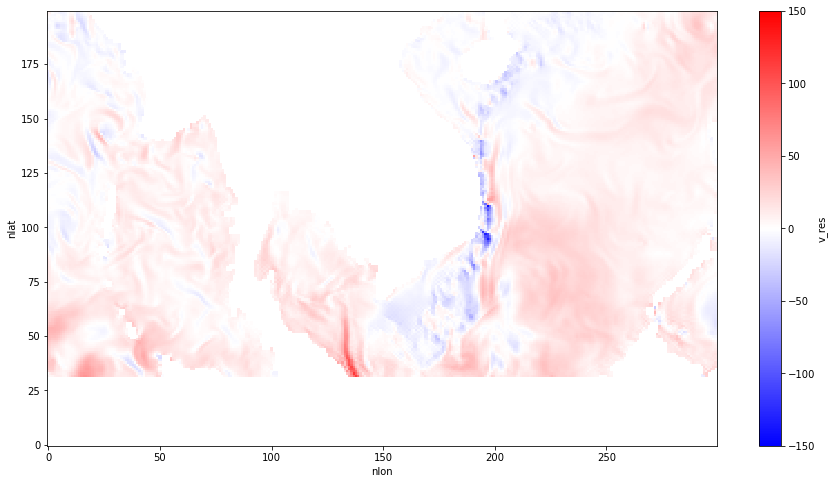

In [54]:
plt.figure(figsize=(15,8))
ds2.v_res[1000:1500,1000:3000][200:400,1000:1300].plot(cmap='bwr', vmin=-150,vmax=150)

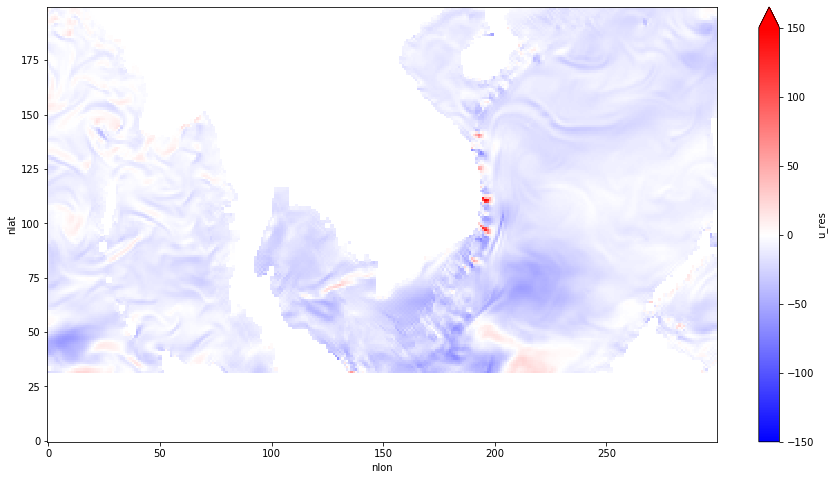

In [53]:
plt.figure(figsize=(15,8))
ds2.u_res[1000:1500,1000:3000][200:400,1000:1300].plot(cmap='bwr', vmin=-150,vmax=150)

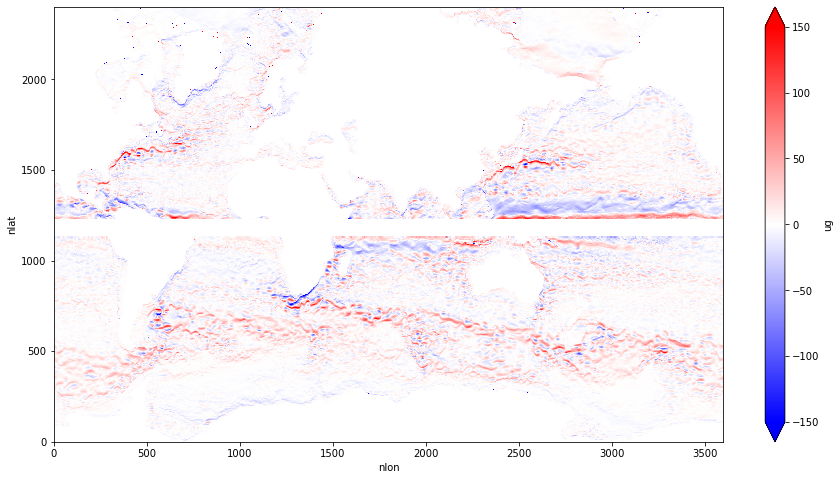

In [33]:
plt.figure(figsize=(15,8))
ds2.ug.plot(cmap='bwr', vmin=-150,vmax=150)

In [ ]:
%time X, y, coords = transform_batch(ds0, return_coords=True)